## **<font color=orange>Lecture Notes/Tutorials by Dr. Bilgic @RIT</font>**

# **Case Study: Seaborn, Plotly and Dash on Santander Bank Data**

### <font color=blue>Topic: EDA and Visualization with Santander Bank Data </font>

Your Task: 

1) Review the code and comments
2) Practice in a new notebook or in new cells (don't copy-paste, do typing)
3) Add more code to analyze the data, get insights, and write an executive summary

***

### **Table of Contents** <a class="anchor" id="0.1"></a>

- [Data Set](#01a)
- [Subset of Data](#01b)
- [Viz with Seaborn](#02)
- [Viz with Plotly](#03)
- [Viz with Plotly Dash](#04)
- [References](#ref)

***

## Data Set <a class="anchor" id="01a"></a>

- Visit https://www.kaggle.com/c/santander-customer-satisfaction, read about the dataset. Either download the data set, train.csv, from there or from workshop folder, train_santander.csv.

- Santander Bank is asking to help identify dissatisfied customers in their relationship with hundreds of anonymized features. Please visit the website and read details about it.

- 743 columns (ID, TARGET, and features), 76020 rows: train and test data sets.

- The "TARGET" column is the variable to predict. It equals one for unsatisfied customers and 0 for satisfied customers.

> target = 'TARGET'

> labels = ['Happy as 0', 'Unhappy as 1']

- I post two versions of data sets: train_santander.csv (import this!) and cleaned_santander.csv (if wanna skip cleaning process).

- In this tutorial, we will initially clean train_santander.csv. Then, for sake of simplicity, we will create and use a cleaned and small portion of this dataset for visualization demo. I will call it df2 here.

- Let's start:

***

## Tasks in Tutorial

- The task: 
    1. to clean and fill missings
    2. to describe the data set using visualization tools in Seaborn, Plotly and Dash
        - univariate summaries
        - bivariate summaries
            - associations
            - correlations
            - patterns
        - multivariate summaries
        - multivariate patterns using drill-down, subsetting, interactive features
    3. to create visualizations that will help to explore or predict the probability that each customer is an unsatisfied customer.
    4. to create visualizations that will help to predict if a customer is satisfied or dissatisfied with their banking experience.
    5. to exted with your contribution

***

## Housekeeping

Know: 
- where you are working
- version check
- shorcuts: https://youtu.be/d0oBRIONOEw

Basic packs to use:
- numpy
- pandas
- seaborn
- matplotlib

***

In [2]:
# Directory working
%pwd #look at the current work dir. import os if needed

'/Users/yusufbilgic/Google Drive yusuf.k.bilgic/Data Science All/My_All_ML_Course_Materials/1.DataAnalytics/2. Data Analysis and Visualization with Python/RIT_Visualization_with_Python_Plotly_Dash'

***

### Step 1: Load data

In [3]:
# Import necessary libraries and load the data
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
# Check version: update if needed
import pandas as pd
pd.__version__

'1.5.2'

In [5]:
#import data from directory
#df is full train dataset
df = pd.read_csv("train_santander.csv", 
                 index_col='ID') # the train dataset is now a Pandas DataFrame

***

## Step 2: Data Wrangling 

In [6]:
# We will use train data set for EDA
# Look the number of rows and columns
df.shape

(76020, 370)

In [7]:
# Data types
df.dtypes

var3                         int64
var15                        int64
imp_ent_var16_ult1         float64
imp_op_var39_comer_ult1    float64
imp_op_var39_comer_ult3    float64
                            ...   
saldo_medio_var44_hace3    float64
saldo_medio_var44_ult1     float64
saldo_medio_var44_ult3     float64
var38                      float64
TARGET                       int64
Length: 370, dtype: object

In [8]:
# Check out the data types, number of entries and other details
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 76020 entries, 1 to 151838
Columns: 370 entries, var3 to TARGET
dtypes: float64(111), int64(259)
memory usage: 215.2 MB


In [9]:
# Check out the first 5 rows of the data set
df.head()

,var3,var15,imp_ent_var16_ult1,imp_op_var39_comer_ult1,imp_op_var39_comer_ult3,imp_op_var40_comer_ult1,imp_op_var40_comer_ult3,imp_op_var40_efect_ult1,imp_op_var40_efect_ult3,imp_op_var40_ult1,...,saldo_medio_var33_hace2,saldo_medio_var33_hace3,saldo_medio_var33_ult1,saldo_medio_var33_ult3,saldo_medio_var44_hace2,saldo_medio_var44_hace3,saldo_medio_var44_ult1,saldo_medio_var44_ult3,var38,TARGET
ID,,,,,,,,,,,,,,,,,,,,,
1,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,39205.170000,0
3,2,34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49278.030000,0
4,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,67333.770000,0
8,2,37,0.0,195.0,195.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64007.970000,0
10,2,39,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117310.979016,0


In [10]:
# NaNs
df.isnull().sum() #try .nlargest() #.sum() 

var3                       0
var15                      0
imp_ent_var16_ult1         0
imp_op_var39_comer_ult1    0
imp_op_var39_comer_ult3    0
                          ..
saldo_medio_var44_hace3    0
saldo_medio_var44_ult1     0
saldo_medio_var44_ult3     0
var38                      0
TARGET                     0
Length: 370, dtype: int64

In [11]:
# Number of columns with all zeros as average
np.sum(df.mean()==0)

34

- Optional cleaning process: the features whose mean is zero is suspicious. Probably dropping them after making sure their variance or standard deviation is zero. You do this!

In [ ]:
# remove_features = ?? # whick features are zero variance to drop?
# df = df.drop(remove_features, axis=1)
# df.shape

Notice the number of columns that decreased from original 371 to 337

In [ ]:
# Number of columns with all zeros
# np.sum(df.mean()==0)

In [13]:
# Uniqueness of values using train.unique for each column
df['TARGET'].unique()

array([0, 1])

In [14]:
# Let's look at classes of the target 
df[['TARGET', 'var3']]

,TARGET,var3
ID,,
1,0,2
3,0,2
4,0,2
8,0,2
10,0,2
...,...,...
151829,0,2
151830,0,2
151835,0,2


In [15]:
# Percent of happy-unhappy customers
df['TARGET'].value_counts() / df.shape[0]

# See this data is a unbalanced and sparsed data. 
# When modeling, this produces an issue that needs to be handled.
# Visually, can we discover unbalanced and sparsed patterns?

0    0.960431
1    0.039569
Name: TARGET, dtype: float64

In [16]:
# Happy customers: TARGET==0 vs Unhappy custormers: TARGET==1
agg_1 = pd.DataFrame(df.TARGET.value_counts())
agg_1['Percentage'] = 100*agg_1['TARGET']/df.shape[0]
agg_1

,TARGET,Percentage
0,73012,96.043147
1,3008,3.956853


***

## Discover data related issues, type issues, all issues before running EDA

In [17]:
# Check the range of each feature and target values
df.describe()

,var3,var15,imp_ent_var16_ult1,imp_op_var39_comer_ult1,imp_op_var39_comer_ult3,imp_op_var40_comer_ult1,imp_op_var40_comer_ult3,imp_op_var40_efect_ult1,imp_op_var40_efect_ult3,imp_op_var40_ult1,...,saldo_medio_var33_hace2,saldo_medio_var33_hace3,saldo_medio_var33_ult1,saldo_medio_var33_ult3,saldo_medio_var44_hace2,saldo_medio_var44_hace3,saldo_medio_var44_ult1,saldo_medio_var44_ult3,var38,TARGET
count,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,...,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,7.602000e+04,76020.000000
mean,-1523.199277,33.212865,86.208265,72.363067,119.529632,3.559130,6.472698,0.412946,0.567352,3.160715,...,7.935824,1.365146,12.215580,8.784074,31.505324,1.858575,76.026165,56.614351,1.172358e+05,0.039569
std,39033.462364,12.956486,1614.757313,339.315831,546.266294,93.155749,153.737066,30.604864,36.513513,95.268204,...,455.887218,113.959637,783.207399,538.439211,2013.125393,147.786584,4040.337842,2852.579397,1.826646e+05,0.194945
min,-999999.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.163750e+03,0.000000
25%,2.000000,23.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.787061e+04,0.000000
50%,2.000000,28.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.064092e+05,0.000000
75%,2.000000,40.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.187563e+05,0.000000
max,238.000000,105.000000,210000.000000,12888.030000,21024.810000,8237.820000,11073.570000,6600.000000,6600.000000,8237.820000,...,50003.880000,20385.720000,138831.630000,91778.730000,438329.220000,24650.010000,681462.900000,397884.300000,2.203474e+07,1.000000


In [18]:
# Data types: all are int or float
df.dtypes.unique()

array([dtype('int64'), dtype('float64')], dtype=object)

In [19]:
# Just check what variables are int
df.dtypes[df.dtypes == 'int64'] #.index, float64

var3                             int64
var15                            int64
ind_var1_0                       int64
ind_var1                         int64
ind_var2_0                       int64
                                 ...  
num_var45_ult3                   int64
saldo_var2_ult1                  int64
saldo_medio_var13_medio_hace3    int64
saldo_medio_var13_medio_ult1     int64
TARGET                           int64
Length: 259, dtype: object

In [20]:
# Let's get the indexes
df.dtypes[df.dtypes == 'int64'].index

Index(['var3', 'var15', 'ind_var1_0', 'ind_var1', 'ind_var2_0', 'ind_var2',
       'ind_var5_0', 'ind_var5', 'ind_var6_0', 'ind_var6',
       ...
       'num_venta_var44_hace3', 'num_venta_var44_ult1', 'num_var45_hace2',
       'num_var45_hace3', 'num_var45_ult1', 'num_var45_ult3',
       'saldo_var2_ult1', 'saldo_medio_var13_medio_hace3',
       'saldo_medio_var13_medio_ult1', 'TARGET'],
      dtype='object', length=259)

In [21]:
# wanna describe only int, object, float64
categoricals = df.dtypes[df.dtypes == 'object'].index
numericals = df.dtypes[df.dtypes != 'object'].index # 

#numericals1 = df.dtypes[df.dtypes == 'int'].index #
#numericals2 = df.dtypes[df.dtypes == 'float64'].index #
#numericals = [numericals1,numericals2]

#print(categoricals) #there is no categorical variables here
#df[categoricals].describe()

df[numericals].describe()

,var3,var15,imp_ent_var16_ult1,imp_op_var39_comer_ult1,imp_op_var39_comer_ult3,imp_op_var40_comer_ult1,imp_op_var40_comer_ult3,imp_op_var40_efect_ult1,imp_op_var40_efect_ult3,imp_op_var40_ult1,...,saldo_medio_var33_hace2,saldo_medio_var33_hace3,saldo_medio_var33_ult1,saldo_medio_var33_ult3,saldo_medio_var44_hace2,saldo_medio_var44_hace3,saldo_medio_var44_ult1,saldo_medio_var44_ult3,var38,TARGET
count,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,...,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,76020.000000,7.602000e+04,76020.000000
mean,-1523.199277,33.212865,86.208265,72.363067,119.529632,3.559130,6.472698,0.412946,0.567352,3.160715,...,7.935824,1.365146,12.215580,8.784074,31.505324,1.858575,76.026165,56.614351,1.172358e+05,0.039569
std,39033.462364,12.956486,1614.757313,339.315831,546.266294,93.155749,153.737066,30.604864,36.513513,95.268204,...,455.887218,113.959637,783.207399,538.439211,2013.125393,147.786584,4040.337842,2852.579397,1.826646e+05,0.194945
min,-999999.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.163750e+03,0.000000
25%,2.000000,23.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.787061e+04,0.000000
50%,2.000000,28.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.064092e+05,0.000000
75%,2.000000,40.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.187563e+05,0.000000
max,238.000000,105.000000,210000.000000,12888.030000,21024.810000,8237.820000,11073.570000,6600.000000,6600.000000,8237.820000,...,50003.880000,20385.720000,138831.630000,91778.730000,438329.220000,24650.010000,681462.900000,397884.300000,2.203474e+07,1.000000


In [22]:
# Use sum and len
np.sum(df['var36']==0)

#len(train[train[i] == 0])

411

***

## Write a code to get basic statistics (min, max, range)

In [13]:
df_ranges = []

# add other statistics
for i in df.columns:
    df_ranges.append([i, df[i].min(), df[i].max(), 
                      df[i].max()-df[i].min(), len(df[df[i] == 0])] )

# Give column names and make data frame of pandas, then print
cols = ['cols','min','max', 'range', 'zeros'] #add more statistic
df_ranges = pd.DataFrame(df_ranges,columns=cols)

df_ranges.head()

# Add Kurtosis and Skewness

,cols,min,max,range,zeros
0,var3,-999999.0,238.00,1000237.00,75
1,var15,5.0,105.00,100.00,0
2,imp_ent_var16_ult1,0.0,210000.00,210000.00,72301
3,imp_op_var39_comer_ult1,0.0,12888.03,12888.03,66075
4,imp_op_var39_comer_ult3,0.0,21024.81,21024.81,64330


In [ ]:
# Sorting
df_ranges.sort_values(by=['zeros','max'], ascending=False, axis=0)

In [ ]:
# See one -999999 in var3
df.var3.value_counts() #all
df.var3.value_counts()[:10] #first 10 levels

In [ ]:
# Dig into issues and redefine
df.loc[df.var3==-999999].shape

In [ ]:
# Replace -999999 with 0
df = df.replace(-999999,0)
df.loc[df.var3==-999999].shape

***

### Data wrangling to discover issues

Play with the data set. Use basic codes from the workshops.

***

### Step 3: Exploratory Data Analysis (EDA) with Basic Functions

In [ ]:
# Let's use a subset of the data
df.shape

For sake of simplicity, we will create a subset of the data as df2:

In [23]:
# Subset of the data: I pick a couple of columns
df2 = df[['var3','var15','var36', 'num_var5', 'var38','imp_ent_var16_ult1','TARGET']]

In [24]:
df2.shape

(76020, 7)

In [25]:
# to get some stats (min, max, range) for each (numerical) columns
for i in df2.columns:
    print(i)
    print('Min:', df2[i].min())
    print('Max:', df2[i].max())
    print('Range:', df2[i].max()-df2[i].min())
    print('*****')

# how to get sd, mean
# add more univariate statistics

var3
Min: -999999
Max: 238
Range: 1000237
*****
var15
Min: 5
Max: 105
Range: 100
*****
var36
Min: 0
Max: 99
Range: 99
*****
num_var5
Min: 0
Max: 15
Range: 15
*****
var38
Min: 5163.75
Max: 22034738.76
Range: 22029575.01
*****
imp_ent_var16_ult1
Min: 0.0
Max: 210000.0
Range: 210000.0
*****
TARGET
Min: 0
Max: 1
Range: 1
*****


In [ ]:
# Also discretizing, relabelling etc work you can do

# ?

In [27]:
# export df2 to a csv file
df2.to_csv('cleaned_santander.csv', index=True)

***

### Start from here if you want to skip the cleaning process above

In [28]:
# import cleaned_santander.csv as df2 again (this will overwrite df2)
df2 = pd.read_csv('cleaned_santander.csv', 
                 index_col='ID') # the train dataset is now a Pandas DataFrame
df2.head(5)

,var3,var15,var36,num_var5,var38,imp_ent_var16_ult1,TARGET
ID,,,,,,,
1,2,23,99,0,39205.170000,0.0,0
3,2,34,3,0,49278.030000,0.0,0
4,2,23,99,3,67333.770000,0.0,0
8,2,37,2,3,64007.970000,0.0,0
10,2,39,1,0,117310.979016,0.0,0


***

## Seaborn <a class="anchor" id="02"></a>

Let's practice with the data and the pack's capacity to get some vizs.

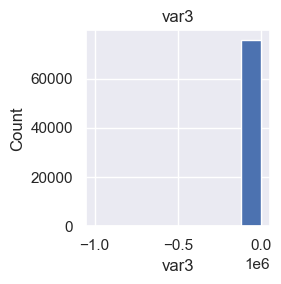

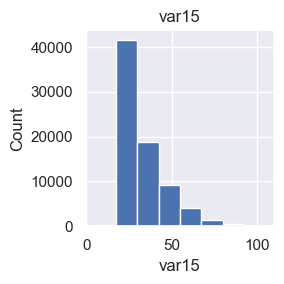

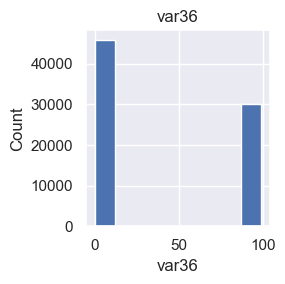

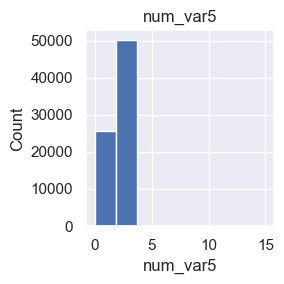

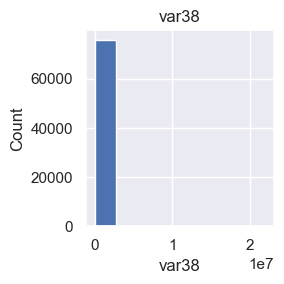

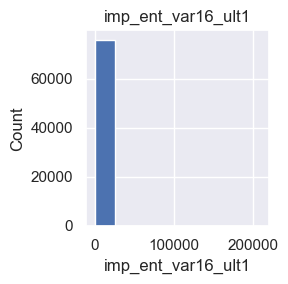

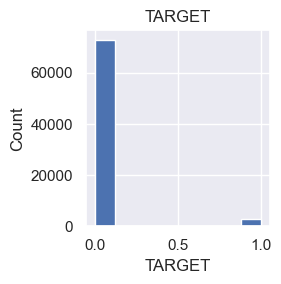

In [29]:
# Histogram of Each Feature
# This will generate bar charts/histogram for each. Later, after feature reductions, you can use it again.
import seaborn as sns

class color:
   BOLD = '\033[1m'
   END = '\033[0m'
for i, col in enumerate(df2.columns):
    sns.set()
    plt.figure(figsize=(3,3)) 
    plt.hist(df2[col], bins=8)
    plt.xlabel(col)
    plt.ylabel('Count')
    plt.title(col)
    plt.tight_layout()
    plt.show()

In [31]:
# Calculate correlation matrix
df2_corr = df2.corr()
print(df2_corr)

                        var3     var15     var36  num_var5     var38  \
var3                1.000000 -0.004452 -0.015205  0.038327  0.000071   
var15              -0.004452  1.000000 -0.145342 -0.098478  0.006497   
var36              -0.015205 -0.145342  1.000000 -0.529148  0.021745   
num_var5            0.038327 -0.098478 -0.529148  1.000000 -0.038785   
var38               0.000071  0.006497  0.021745 -0.038785  1.000000   
imp_ent_var16_ult1  0.001868  0.043722 -0.044468  0.018402  0.000007   
TARGET              0.004475  0.101322  0.102919 -0.134095 -0.019510   

                    imp_ent_var16_ult1    TARGET  
var3                          0.001868  0.004475  
var15                         0.043722  0.101322  
var36                        -0.044468  0.102919  
num_var5                      0.018402 -0.134095  
var38                         0.000007 -0.019510  
imp_ent_var16_ult1            1.000000 -0.000017  
TARGET                       -0.000017  1.000000  


<AxesSubplot: >

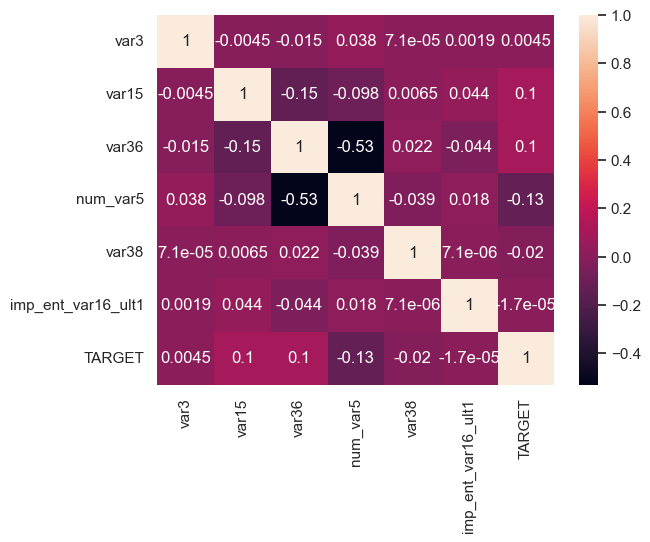

In [32]:
# Heatmap using seaborn
# You may want to run this after eliminating features
import seaborn as sns
sns.heatmap(df2_corr,annot=True)

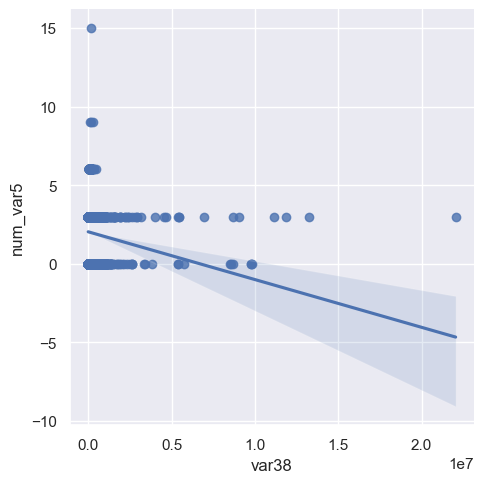

In [33]:
# Scatter plot with fitted line
sns.lmplot(x='var38', y='num_var5', data=df2)

plt.show()

# Evaluate the plot. Discuss does this tell us anythings?

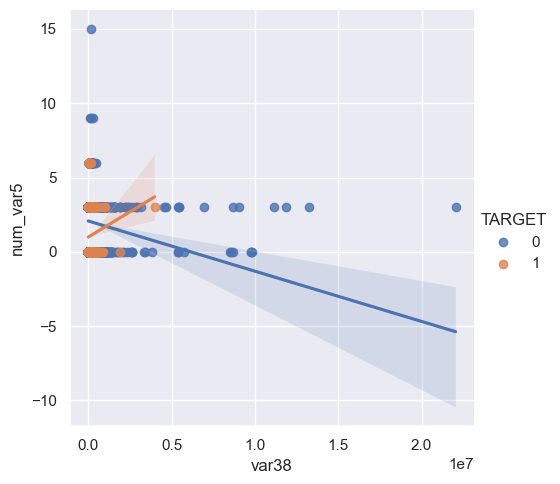

In [34]:
sns.lmplot(x='var38', y='num_var5', 
           hue='TARGET', data=df2, fit_reg=True)

plt.show()

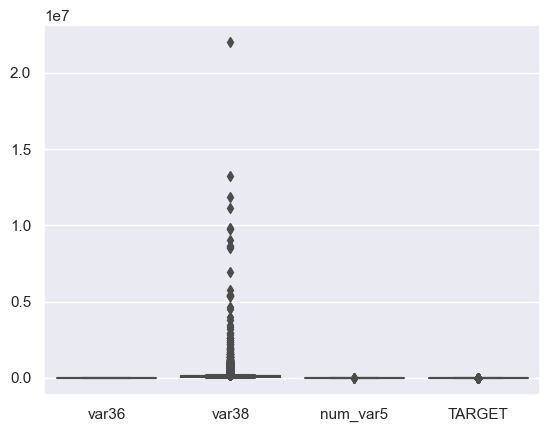

In [35]:
# Boxplot
sns.boxplot(data=df2[['var36','var38','num_var5', 'TARGET']])

plt.show()

# This is not a good plot!
# Discuss: On the same scale plot of fatures, it is not good idea. Need to do seperate or scale.
# Task: How to scale and how to seperately plot boxplots?

In [36]:
# Check var38 min, max etc
print(df2['var38'].unique())

df2[['var38']].describe()

[ 39205.17  49278.03  67333.77 ... 118634.52  74028.15  84278.16]


,var38
count,7.602000e+04
mean,1.172358e+05
std,1.826646e+05
min,5.163750e+03
25%,6.787061e+04
50%,1.064092e+05
75%,1.187563e+05
max,2.203474e+07


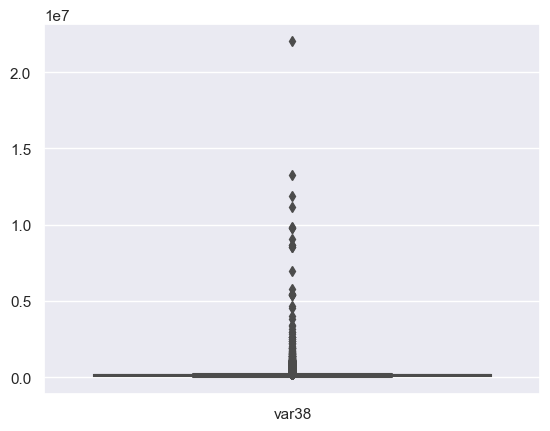

In [37]:
# Boxplot

sns.boxplot(data=df2[['var38']])

plt.show()

# this is also not a good plot: need brushing

In [38]:
df2['var38'].unique()

array([ 39205.17,  49278.03,  67333.77, ..., 118634.52,  74028.15,
        84278.16])

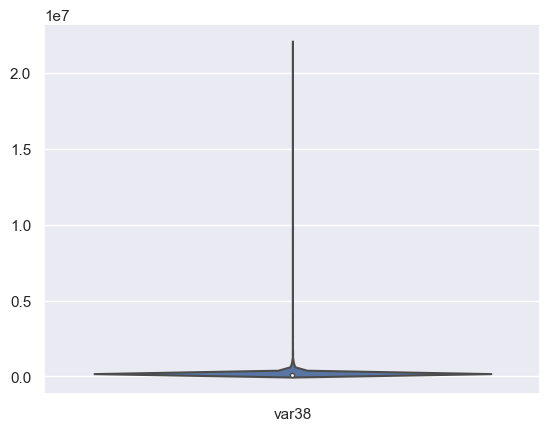

In [39]:
sns.violinplot(data=df2[['var38']])

plt.show()

# need interactive features to zoom-in

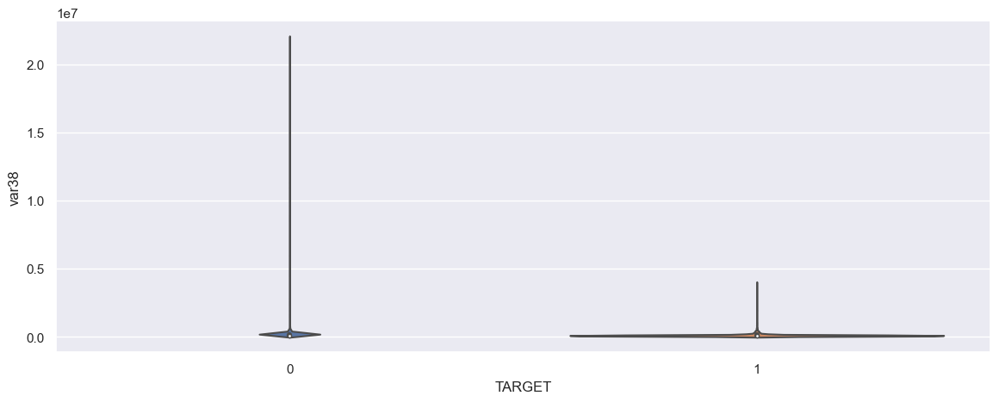

In [40]:
# Change figure size
plt.figure(figsize=(14,5))

#sns.violinplot('var38', data=train)

sns.violinplot(x='TARGET', y='var38', data=df2)

plt.show()

# Violin plot

In [41]:
df2.columns

Index(['var3', 'var15', 'var36', 'num_var5', 'var38', 'imp_ent_var16_ult1',
       'TARGET'],
      dtype='object')

/var/folders/4y/scfbvxfs14166p00926kjbqc0000gn/T/ipykernel_52742/1061435872.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df2['var38'], color='blue', axlabel='aa').set_title('xyz?')


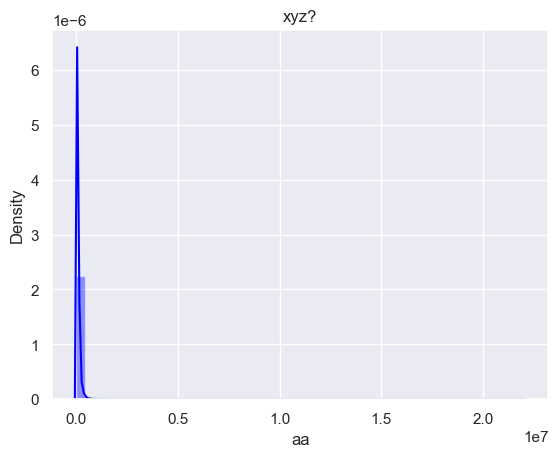

In [44]:
# Distribution plot: 
sns.distplot(df2['var38'], color='blue', axlabel='aa').set_title('xyz?')
plt.show()

[Text(0, 0, '411'),
 Text(0, 0, '14664'),
 Text(0, 0, '8704'),
 Text(0, 0, '22177'),
 Text(0, 0, '30064')]

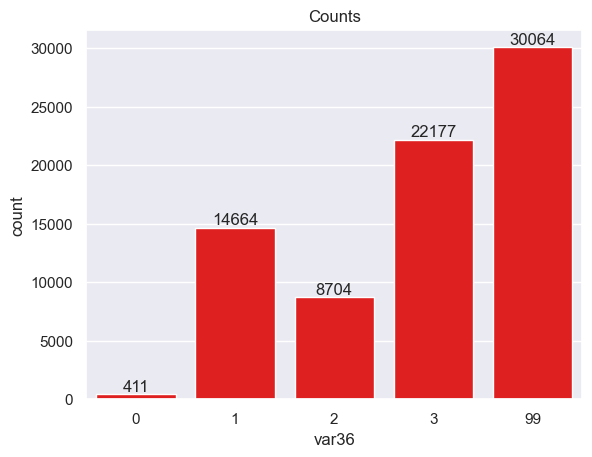

In [45]:
# Count plot showing counts
ax=sns.countplot(x='var36', data=df2,color='red') #, hue='TARGET'

ax.set_title('Counts')

ax.bar_label(ax.containers[0])

# Rotate labels
#plt.xticks(rotation=90)

In [48]:
# Joint plot: bivariate
# This take time to get: fix is issue pops up.
sns.jointplot(df2.var38, df2.num_var5, data=df2, kind='kde', color='blue')

TypeError: jointplot() got multiple values for argument 'data'

/Applications/anaconda3/envs/mydsenv/lib/python3.9/site-packages/seaborn/axisgrid.py:2095: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


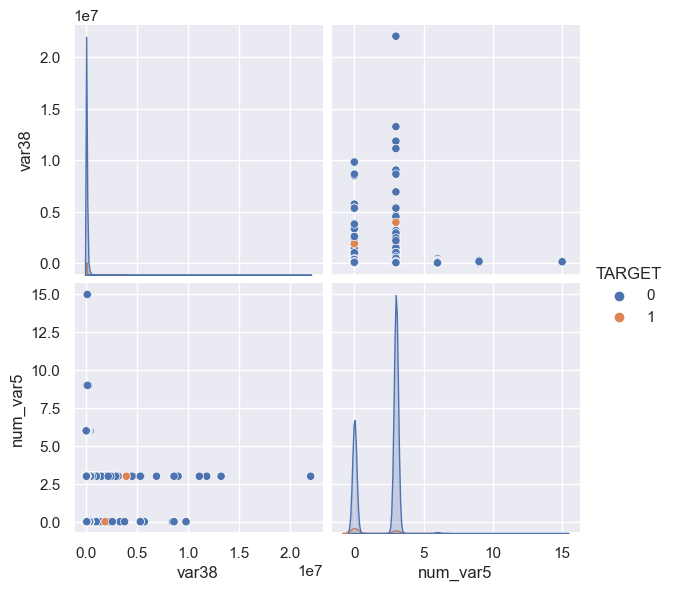

In [54]:
# A colorful bivariate plot
# Target: You can play. Get this after you fit.
sns.pairplot(df2[['var38','num_var5','TARGET']], hue ='TARGET', size=3)


- So far, the plots are not dynamic-interactive-user friendly.

***

### Your turn

Add below your designs using Seaborn Pack.

***

## Plotly <a class="anchor" id="03"></a>

It is interactive effective tool for data visualization and EDA. Let's practice some features.

In [55]:
import plotly.express as px

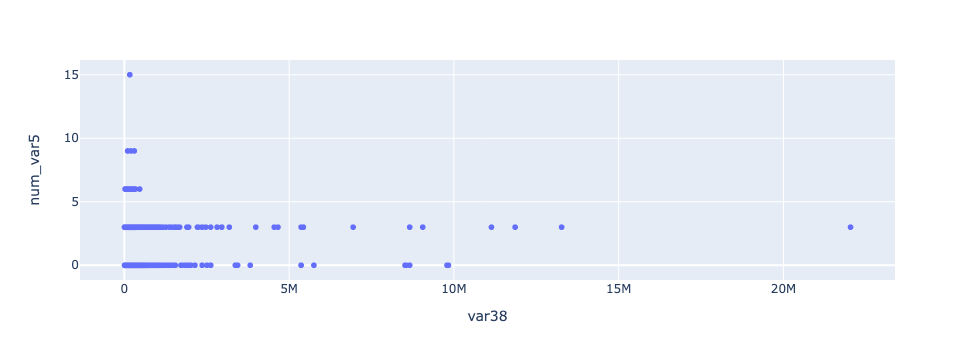

In [56]:
# Scatter plot
fig = px.scatter(df2, x='var38', y='num_var5')

fig.show()
# This may not work right away. May need to install pack from pip or terminal. Jupyter-lab has issues with it.

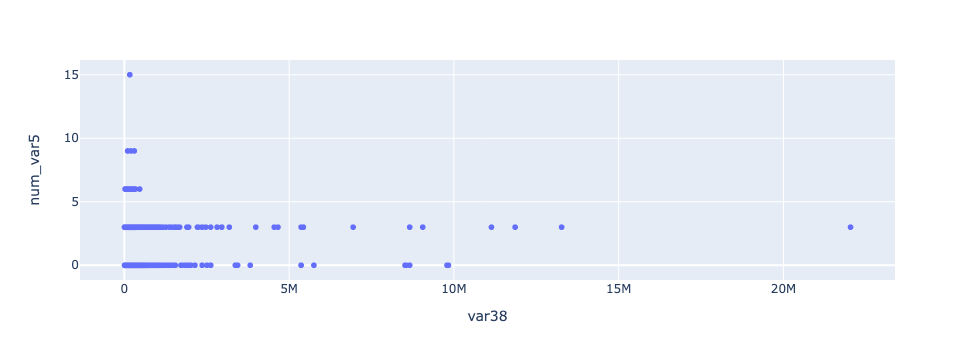

In [57]:
# Hovering features
fig = px.scatter(df2, x='var38', y='num_var5', hover_data=['TARGET'])

fig.show()

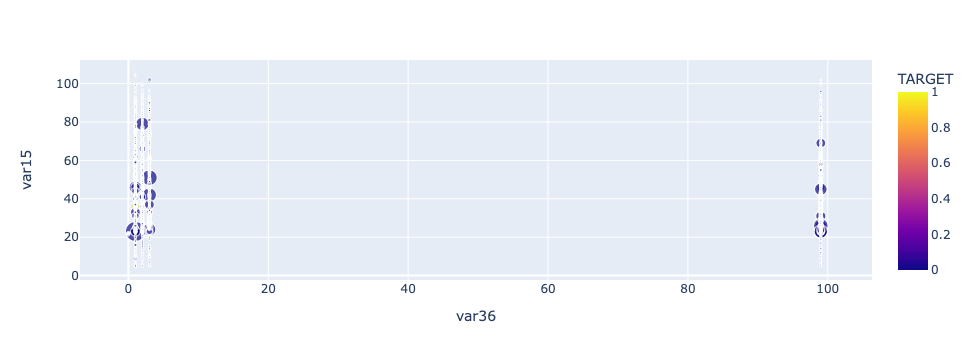

In [58]:
# Showing total along with hovering features
# Fix it
fig = px.scatter(data_frame=df2, x='var36', y='var15', 
                 hover_data=['TARGET'], size='var38', color='TARGET')

fig.show()

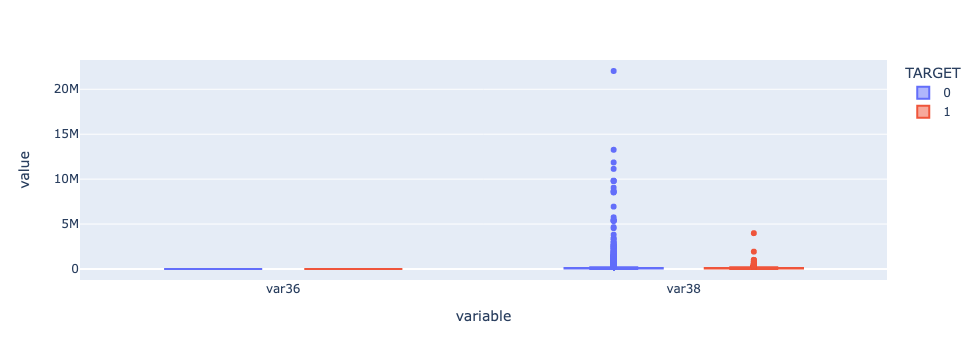

In [59]:
# Showing total along with hovering features
fig = px.box(df2[['var36','var38', 'TARGET']],  color='TARGET')

fig.show()

- Ugly plot, scales are not same :) You ca change the scale in the beginning. 
- Then it will be easy to compare

***

### Your turn

Add below your designs using Seaborn Pack.

***

### Optional - Package Pandas-Profiling

Import the pack or upoad it from https://github.com/pandas-profiling/pandas-profiling.

Shortly, this generates profile reports from a pandas DataFrame. The pandas df.describe() function is great but a little basic for serious exploratory data analysis. pandas_profiling extends the pandas DataFrame with df.profile_report() for quick data analysis.

The issues will appear in dealing with large data report. Try!

In [ ]:
# Install here or using pip: >> pip install pandas-profiling
from pandas_profiling import ProfileReport

In [ ]:
profile = ProfileReport(df2, title="Pandas Profiling Report", 
                        explorative=False)

profile.to_file("df2_report.html")

__NOTE__: Pandas-profiling may NOT process the data due to its size and not enough compute resource

***

# Plotly Dash <a class="anchor" id="04"></a>

Visit the workshop and the official gallery, and practice them below. Some issues will appear. Skip if not manageble.

Then, visit https://dash.plotly.com/dash-core-components and practice some components.

In [2]:
# import cleaned_santander.csv as df2 again (this will overwrite df2)
import pandas as pd
df2 = pd.read_csv('cleaned_santander.csv', 
                 index_col='ID') # the dataset is now a Pandas DataFrame

In [3]:
# Subsetting data
df2[['var15','var36','var38','TARGET']].head()

,var15,var36,var38,TARGET
ID,,,,
1,23,99,39205.170000,0
3,34,3,49278.030000,0
4,23,99,67333.770000,0
8,37,2,64007.970000,0
10,39,1,117310.979016,0


In [4]:
# Checking levels
df2.TARGET.unique()[1] #try 0,1

1

In [5]:
# Did you install these packs first using the instruction in the prev tutorials?
# Do it so! Then:

# Import packs
import dash
import plotly.express as px

from jupyter_dash import JupyterDash

from dash import Dash, html, dcc, Input, Output

import pandas

# Load Data with 3 predictors and one target
df = df2[['var15','var36','var38','TARGET']]

In [6]:
# inline example

## Build App

# This is for inline
app = JupyterDash(__name__)

# This is for .py file port display
# app = dash.Dash(__name__)

# Create layout object 
app.layout = html.Div([
    
    html.H1("Add A title"),
    
    dcc.Graph(id='graph'),
    
    html.Label([
        "colorscale",
        
        #just wanna get different colors
        dcc.Dropdown(
            id='colorscale-dropdown', clearable=False,
            value='plasma', options=[
                {'label': c, 'value': c}
                for c in px.colors.named_colorscales()
            ]),
        
        
    ]),
])

# Define callback to update graph: This connects dash to plotly
@app.callback(
    Output('graph', 'figure'),
    [Input("colorscale-dropdown", "value")]
)
def update_figure(colorscale):
    return px.scatter(
        df, x="var38", y="var15", color="TARGET",
        color_continuous_scale=colorscale,
        render_mode="webgl", title="Add a subtitle"
    )

# Run app and display result inline in the notebook
app.run_server(mode='inline') #change to external, inline

***

Now, let's modify the code with new features: add slider, radio button etc.

Let's focus on https://dash.plotly.com/dash-core-components/dropdown

In [9]:
# Just in case what data frame we work:
# import packs
import dash
import plotly.express as px

from jupyter_dash import JupyterDash

from dash import Dash, html, dcc, Input, Output

import pandas

# Load Data
df = df2[['var15','var36','var38','TARGET']]

df.shape

(76020, 4)

In [10]:
# inline example

## Build App

# This is for inline
app = JupyterDash(__name__)

# This is for .py file port display
# app = dash.Dash(__name__)

# Create layout object 
app.layout = html.Div([
    html.H1("Add A title"),
    dcc.Graph(id='graph'),
    html.Label([
        "TARGET", #colorscale, df2['TARGET'].unique()
        
        #just wanna get different colors
        # dcc.Dropdown(
        #     id='colorscale-dropdown', clearable=False,
        #     value='0', options=[
        #         {'label': c, 'value': {0,1} }
        #         for c in df2['TARGET'].unique()
        #     ]),
        
       # dcc.Dropdown(['New York City', 'Montréal', 'San Francisco'],
       #              'Montréal')
 
        dcc.Dropdown(
            id='target-dropdown', clearable=False,
            options=[
                    #df.TARGET.unique()  #df.nation.unique()
                   {'label': 0, 'value': 0},
                   {'label': 1, 'value': 1},
                    ]
            
           ,value=0 #, multi=True
                    )
        
    
        
    ]),
])

# Define callback to update graph: This connects dash to plotly
@app.callback(
    Output('graph', 'figure'),
    [Input('target-dropdown', 'value')]
)
def update_figure(value):
    return px.scatter(
        df[df['TARGET']==value], x="var38", y="var15", #color="TARGET",
        color='TARGET', size='var36',#colorscale,df2['TARGET'].unique(),df[df['TARGET']==TARGET]
        render_mode="webgl", title="Add a subtitle"
    )

# Run app and display result inline in the notebook
app.run_server(mode='inline') #change to external, inline

In [12]:
# Just play with visual aspects
# ?

Wanna learn more? Let me know. YB

***

### Extension on Viz

- See many notebooks prepared regarding this dataset: https://www.kaggle.com/c/santander-customer-satisfaction. Visit and check visualizations. Pick some below and practice. Feel free to use the full data.

***

# Resources/Referencess <a class="anchor" id="ref"></a>

- My main resource: Plotly Dash, Plotly official websites

- See many notebooks prepared regarding this dataset: https://www.kaggle.com/c/santander-customer-satisfaction. Visit and check visualizations. Pick here and practice. Feel free to use the full data.

- https://www.kaggle.com/cast42/exploring-features ==> nice notebook to practice